
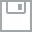
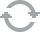
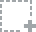
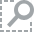
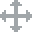
...
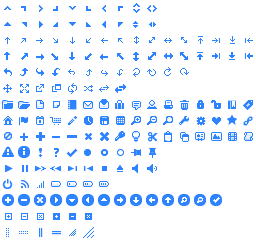
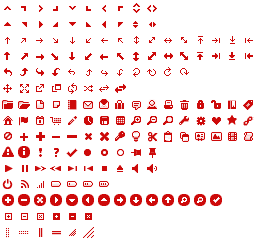
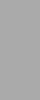
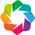
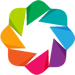

In [1]:
from bokeh.io import output_notebook, show
from bokeh.plotting import figure, output_file, show
import pandas as pd
import numpy as np
output_notebook()

In [2]:
RFD=pd.read_csv('RFDALL.txt',parse_dates=True, index_col=1, na_values=["M"])
#RFD=RFD[RFD.tmpf >= 90]
#print'ready'
#dateparse = lambda x: pd.datetime.strptime(x, '%Y-%m-%d %H:%M')
#RFD = pd.read_csv('RFD3.txt', parse_dates=['valid'], date_parser=dateparse)
print'ready'

ready


In [9]:
print RFD

                    station   tmpf
valid                             
1970-01-01 00:00:00     RFD  35.06
1970-01-01 03:00:00     RFD  28.94
1970-01-01 06:00:00     RFD  23.00
1970-01-01 09:00:00     RFD  21.02
1970-01-01 12:00:00     RFD  21.02
1970-01-01 15:00:00     RFD  21.92
1970-01-01 18:00:00     RFD  26.06
1970-01-01 21:00:00     RFD  24.98
1970-01-02 00:00:00     RFD  21.02
1970-01-02 03:00:00     RFD  21.90
1970-01-02 06:00:00     RFD  21.92
1970-01-02 09:00:00     RFD  19.04
1970-01-02 12:00:00     RFD  15.98
1970-01-02 15:00:00     RFD  15.98
1970-01-02 18:00:00     RFD  19.04
1970-01-02 21:00:00     RFD  19.94
1970-01-03 00:00:00     RFD  12.90
1970-01-03 03:00:00     RFD  15.08
1970-01-03 06:00:00     RFD  15.98
1970-01-03 09:00:00     RFD  15.98
1970-01-03 12:00:00     RFD  15.08
1970-01-03 15:00:00     RFD  10.94
1970-01-03 18:00:00     RFD  12.92
1970-01-03 21:00:00     RFD  12.92
1970-01-04 00:00:00     RFD   8.06
1970-01-04 03:00:00     RFD   3.92
1970-01-04 06:00:00 

In [6]:
T=pd.Series(RFD['tmpf'])
T90=T.quantile(0.9)
T50=T.quantile(0.5)
T10=T.quantile(0.1)
df=pd.DataFrame(RFD, columns = ['valid', 'tmpf'])

In [122]:
print df['tmpf'].describe(percentiles=[.9,.1])
print T50

count    404873.000000
mean         48.542259
std          21.602175
min         -27.040000
10%          21.020000
50%          48.920000
90%          75.920000
max         104.000000
Name: tmpf, dtype: float64
48.92


In [7]:
TOOLS = ("pan,wheel_zoom,box_zoom,reset,save")
p=figure(tools=TOOLS, plot_width=2000, plot_height=400, x_axis_type="datetime")


p.line(RFD.index.to_series(), RFD['tmpf'],
       line_color="red", line_width=.1, legend='T')
p.line(RFD.index.to_series(), T90, color='darkorange', legend='90%(75.92°F)')
p.line(RFD.index.to_series(), T50, color='gold', legend='50%(48.92°F)')
p.line(RFD.index.to_series(), T10, color='green', legend='10%(21.02°F')
p.line(RFD.index.to_series(), 104, color='fuchsia', legend='MAX(104°F)')
p.line(RFD.index.to_series(), -27.04, color='navy', legend='MIN(-27.04°F)')

'''
#p.circle(RFD.index.to_series(), RFD['tmpf'],
#       line_color="red", line_width=1, legend="T")
#p.line(RFD.index.to_series(), RFD['dwpf'],
#       line_color="green", line_width=1, legend="Td")
#p.line(RFD.index.to_series(), RFD['relh'],
#       line_color="purple", line_width=1, legend="RelH")
#fix y-axis: need double for VSBY
#p.line(RFD.index.to_series(), RFD['vsby'],
#       line_color="darkgray", line_width=1, legend="VSBY")
#fix y-axis: need double for MSLP
#p.line(RFD.index.to_series(), RFD['mslp'],
#       line_color="navy", line_width=1, legend="MSLP")
'''
p.title = "T @ KRFD 1970-2015"
p.xgrid[0].grid_line_color=None
p.ygrid[0].grid_line_alpha=0.5
p.xaxis.axis_label = 'Time (Z)'
p.yaxis.axis_label = 'T (°F)'
p.legend.background_fill_alpha=0
output_file('RFDALL.html')
show(p)